## import library

In [1]:
### BFA & ZeBRA Library

from torch.utils.data import Dataset, DataLoader
from torchvision import datasets, transforms
import torch.nn as nn
import torch.optim as optim
import copy
import torch
import random

from __future__ import division
from __future__ import absolute_import

import os, sys, shutil, time, random
import argparse
import torch
import torch.backends.cudnn as cudnn
import torchvision.datasets as dset
import torchvision.transforms as transforms
from utils import AverageMeter, RecorderMeter, time_string, convert_secs2time, clustering_loss, change_quan_bitwidth
from torch.utils.tensorboard import SummaryWriter

import models
from models.quantization import quan_Conv2d, quan_Linear, quantize

from attack.BFA import *
import torch.nn.functional as F
import copy
from distilled.distilled_data import distilled_dataset, distilled_target_dataset

### log library
import pandas as pd
import numpy as np


### gradcam library
from gradcam.gradcam import GradCAM, ScoreCAM
from gradcam.gradcam_utils import visualize_cam, Normalize
import cv2
from torchvision.utils import make_grid, save_image
import matplotlib.pyplot as plt

%matplotlib inline

## validate code

In [2]:
def accuracy(output, target, topk=(1, )):
    """Computes the precision@k for the specified values of k"""
    with torch.no_grad():
        maxk = max(topk)
        batch_size = target.size(0)

        _, pred = output.topk(maxk, 1, True, True)
        pred = pred.t()
        correct = pred.eq(target.reshape(1, -1).expand_as(pred))
        res = []
        for k in topk:
            correct_k = correct[:k].reshape(-1).float().sum(0)
            res.append(correct_k.mul_(100.0 / batch_size))
        return res
    
def validate(val_loader, model, criterion, summary_output=False):
    losses = AverageMeter()
    top1 = AverageMeter()
    top5 = AverageMeter()

    # switch to evaluate mode
    model.eval()
    output_summary = [] # init a list for output summary
    output_classes = np.zeros(len(val_loader.dataset.classes))

    with torch.no_grad():
        for i, (input, target) in enumerate(val_loader):
            if torch.cuda.is_available():
                target = target.cuda()
                input = input.cuda()

            # compute output
            output = model(input)
            loss = criterion(output, target)
            
            # summary the output
            if summary_output:
                tmp_list = output.max(1, keepdim=True)[1].flatten().cpu().numpy() # get the index of the max log-probability
                output_summary.append(tmp_list)

            # measure accuracy and record loss
            #print("pdh_acc : ", len(target[target==torch.argmax(output, dim=1)])/len(target))
            prec1, prec5 = accuracy(output.data, target, topk=(1, 5))
            #print("val_temp_acc : ", prec1)
            losses.update(loss.item(), input.size(0))
            top1.update(prec1.item(), input.size(0))
            top5.update(prec5.item(), input.size(0))
            
            temp_output_classes = np.array([(output.max(1)[1]==idx).cpu().detach().numpy().sum() for idx in range(len(val_loader.dataset.classes))])
            output_classes +=temp_output_classes

        print(
            '  **Test** Prec@1 {top1.avg:.3f} Prec@5 {top5.avg:.3f} Error@1 {error1:.3f}'
            .format(top1=top1, top5=top5, error1=100 - top1.avg))
        
    if summary_output:
        output_summary = np.asarray(output_summary).flatten()
        return top1.avg, top5.avg, losses.avg, output_classes ,output_summary
    else:
        return top1.avg, top5.avg, losses.avg, output_classes


## gradcam library

In [3]:
def denormalize(tensor, mean, std, idx=0):
    # 복제하고, 자동미분 끄고, numpy로
    image = tensor.clone().detach().numpy()[idx]
    # 데이터 형태는 color channel 3, 32, 32
    image = image.transpose(1, 2, 0)
    # denormalize
    image = image * std + mean
    # 데이터를 0과 1사이로만 있도록 보정
    image = image.clip(0, 1)
    image = image.transpose(2, 0, 1)
    return image

def visualize2_cam(mask, data, mean, std, idx=0):
    """Make heatmap from mask and synthesize GradCAM result image using heatmap and img.
    Args:
        mask (torch.tensor): mask shape of (1, 1, H, W) and each element has value in range [0, 1]
        img (torch.tensor): img shape of (1, 3, H, W) and each pixel value is in range [0, 1]
        
    Return:
        heatmap (torch.tensor): heatmap img shape of (3, H, W)
        result (torch.tensor): synthesized GradCAM result of same shape with heatmap.
    """
    datacpu = data.cpu()
    maskcpu = mask.cpu()
    image = denormalize(datacpu, mean, std, idx)
    heatmap = cv2.applyColorMap(np.uint8(255 * maskcpu.squeeze()), cv2.COLORMAP_JET)
    heatmap = torch.from_numpy(heatmap).permute(2, 0, 1).float().div(255)
    b, g, r = heatmap.split(1)
    heatmap = torch.cat([r, g, b])

    heatnp = heatmap.numpy()
    result = heatnp + image
    result = result / (result.max())
    
    return image, result

def score_cam_get_heatmap(arch, data, target, mean, std, image_idx_arr, layer_target_arr, find_func="name",true_class_idx=True):
    
    image_arr = []
    logit_arr = []
    for image_idx in image_idx_arr:
        
        original_image = denormalize(data, mean, std, image_idx)
        original_image = torch.from_numpy(original_image)
        layer_arr = []
        layer_arr.append(original_image)
        
        for layer_target_idx in layer_target_arr:
            grad_cam_dict = dict(type="resnet", arch=arch, layer_target=layer_target_idx, find_func=find_func,
                                 input_size=(data[0].shape[1], data[0].shape[2]))

            if true_class_idx==True:

                print("target {} detect".format(target[image_idx]))
                gradCAM = ScoreCAM(grad_cam_dict)
                mask, logit = gradCAM(data[image_idx].unsqueeze(0).cuda(), target[image_idx])

            elif true_class_idx ==False:
                gradCAM = ScoreCAM(grad_cam_dict)
                mask, logit = gradCAM(data[image_idx].unsqueeze(0).cuda())

            else:
                print("target {} detect".format(true_class_idx))
                gradCAM = ScoreCAM(grad_cam_dict)
                mask, logit = gradCAM(data[image_idx].unsqueeze(0).cuda(), true_class_idx)

            _, result = visualize2_cam(mask, data, mean, std, image_idx)
            result = torch.from_numpy(result)
            layer_arr.append(result)

        
        logit_arr.append(logit.argmax(1))
        stack_layer = torch.stack(layer_arr, 0)
        image_arr.append(stack_layer)
    
    return image_arr, logit_arr

def grad_cam_get_heatmap(arch, data, target, mean, std, image_idx_arr, layer_target_arr, find_func="name",true_class_idx=True):
    """
    arch : model 형태
    data : 이미지
    target : label
    mean, std : normalize에 필요한 값
    image_idx_arr : 배치 이미지 중 visualize에 사용할 이미지의 idx array
    layer_target_arr : visualize 할 layer에 대한 idx array
    find_func : gradCAM 사용 시 레이어를 찾을 때 사용할 function
    true_class_idx : gradCAM 사용 시 실제 정답 label을 사용할 지 모델이 추측한 label을 사용할 지에 대한 파라미터
    
    """
    image_arr = []
    logit_arr = []
    for image_idx in image_idx_arr:
    
        original_image = denormalize(data, mean, std, image_idx)
        original_image = torch.from_numpy(original_image)
        layer_arr = []
        layer_arr.append(original_image)
        
        for layer_target_idx in layer_target_arr:
            grad_cam_dict = dict(type="resnet", arch=arch, layer_target=layer_target_idx, find_func=find_func,
                                 input_size=(data[0].shape[1], data[0].shape[2]))
            if true_class_idx==True:

                print("true target {} detect".format(target[image_idx]))
                gradCAM = GradCAM(grad_cam_dict)
                mask, logit = gradCAM(data[image_idx].unsqueeze(0).cuda(), target[image_idx])
            elif true_class_idx ==False:
                print("predict target {} detect".format(true_class_idx))
                gradCAM = GradCAM(grad_cam_dict)
                mask, logit = gradCAM(data[image_idx].unsqueeze(0).cuda())

            else:
                print("Specified target {} detect".format(true_class_idx))
                gradCAM = GradCAM(grad_cam_dict)
                mask, logit = gradCAM(data[image_idx].unsqueeze(0).cuda(), true_class_idx)

            _, result = visualize2_cam(mask, data, mean, std, image_idx)
            result = torch.from_numpy(result)
            layer_arr.append(result)
        
        logit_arr.append(logit.argmax(dim=1))
        stack_layer = torch.stack(layer_arr, 0)
        image_arr.append(stack_layer)
    
    return image_arr, logit_arr

def compare_cam(model_arr, data, target, mean, std, image_idx_arr, layer_target_arr, find_func="name", true_class_idx=True):
    model_grad_arr = []
    model_score_arr = []
    for model in model_arr:
        model.eval()
        grad_image_arr, logit_arr = grad_cam_get_heatmap(model, data, target, mean, std, image_idx_arr, layer_target_arr, find_func, true_class_idx)
        model_grad_arr.append((grad_image_arr, logit_arr))
        #score_image_arr, logit_arr = score_cam_get_heatmap(model, data, target, mean, std, image_idx_arr,layer_target_arr, find_func, true_class_idx)
        #model_score_arr.append((score_image_arr, logit_arr))
    
    return model_grad_arr #, model_score_arr

## hyperparam setting
### Dataset setting

In [4]:
# hyperparam setting
dataset = 'imagenet'
data_path = '../data/'
batch_size = 64
workers = 8
save_path = './save'
save_csv_path = './save/csv'
tb_path = './save/tb_log'
valid_path = "/dataset/ImageNet/Classification/val" # set imagenet datapath
manual_seed = 1
random.seed(manual_seed)
torch.manual_seed(manual_seed)

torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

N_iter = 100

if torch.cuda.is_available():
    torch.cuda.manual_seed_all(manual_seed)
    use_cuda = True

#dataset standarized parameter setting
if dataset == 'cifar10':
    mean = [x / 255 for x in [125.3, 123.0, 113.9]]
    std = [x / 255 for x in [63.0, 62.1, 66.7]]
elif dataset == 'imagenet':
    mean = [0.485, 0.456, 0.406]
    std = [0.229, 0.224, 0.225]
    
    
#dataset에 들어가는 transform 만들기

if dataset == 'imagenet':
    train_transform = transforms.Compose([
        transforms.RandomResizedCrop(224),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize(mean, std)
    ])
    test_transform = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean, std)
    ])  # here is actually the validation dataset
else:
    train_transform = transforms.Compose([
        transforms.RandomHorizontalFlip(),
        transforms.RandomCrop(32, padding=4),
        transforms.ToTensor(),
        transforms.Normalize(mean, std)
    ])
    test_transform = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize(mean, std)])

    
#dataset 불러오기
if dataset == 'cifar10':
    train_data = dset.CIFAR10(data_path,
                              train=True,
                              transform=train_transform,
                              download=True)
    test_data = dset.CIFAR10(data_path,
                             train=False,
                             transform=test_transform,
                             download=True)
    train_loader = torch.utils.data.DataLoader(train_data,
                                              batch_size=batch_size,
                                              shuffle=True,
                                              num_workers=workers,
                                              pin_memory=True,
                                             worker_init_fn=np.random.seed(1)
                                         )


    test_loader = torch.utils.data.DataLoader(test_data,
                                              batch_size=batch_size,
                                              shuffle=True,
                                              num_workers=workers,
                                              pin_memory=True,
                                             worker_init_fn=np.random.seed(1)
                                         )


    
if dataset == 'imagenet':
    test_data = dset.ImageFolder(valid_path,
                             transform=test_transform
                             )
    
    test_loader = torch.utils.data.DataLoader(test_data,
                                              batch_size=batch_size,
                                              shuffle=True,
                                              num_workers=workers,
                                              pin_memory=True,
                                             worker_init_fn=np.random.seed(1)
                                         )


#dataloader 생성(단 imagenet이기에 validation만)
idx_to_target_dict = dict(map(reversed, test_data.class_to_idx.items()))
#print(idx_to_target_dict)

### pretrained model setting
#### model and bitwidth setting

In [5]:
model_names = sorted(name for name in models.__dict__
                     if name.islower() and not name.startswith("__")
                     and callable(models.__dict__[name]))
print(model_names)

['alexnet_quan', 'mobilenet_v2', 'mobilenet_v2_quan', 'mobilenetv2_cifar_quan', 'resnet18', 'resnet18_quan', 'resnet20_bin', 'resnet20_quan', 'resnet32_quan', 'resnet34_quan', 'resnet44_quan', 'resnet50_quan', 'resnet56_quan', 'vanilla_resnet20', 'vgg11', 'vgg11_bn', 'vgg11_bn_bin', 'vgg11_bn_quan', 'vgg11_quan']


In [6]:
arch_name = "mobilenet_v2_quan"
#arch_name="resnet20_quan"

if dataset == "cifar10":
    arch_pretrained_path = "./pretrained/resnet20_8bit_cifar10_92_41.pth.tar"
#    arch_pretrained_path = "./pretrained/resnet32_4bit_cifar10_89_76.pth.tar"
else:
    arch_pretrained_path = None
    
change_bit_width = 8

In [7]:
net = models.__dict__[arch_name]()

if arch_pretrained_path is not None:
    if os.path.isfile(arch_pretrained_path):
        net_checkpoint = torch.load(arch_pretrained_path)
        state_tmp = net.state_dict()
        if 'state_dict' in net_checkpoint.keys():
            state_tmp.update(net_checkpoint['state_dict'])
        else:
            state_tmp.update(net_checkpoint)

        net.load_state_dict(state_tmp)
        print("load checkpoint")
    


for m in net.modules():
    if isinstance(m, quan_Conv2d) or isinstance(m, quan_Linear):
        m.__reset_stepsize__()
        m.__reset_weight__()
        

criterion = torch.nn.CrossEntropyLoss()

if use_cuda:
    net.cuda()
    criterion.cuda()

#prec1, prec5, loss, output_classes = validate(test_loader, net, criterion)

In [8]:
net_clean = copy.deepcopy(net)
data, target = iter(test_loader).next()
net_clean.eval()
net_clean.cuda()
predict = torch.argmax(net_clean(data.cuda()), dim=1)

In [9]:
true_predict_index = target == predict.cpu()
true_data, true_target = data[true_predict_index], target[true_predict_index]
print(target)
print(predict)
print("batch accuracy : ",len(target[target==predict.cpu()])/len(target))

tensor([493, 362, 763, 347, 638, 438,  31, 694, 777, 334, 417, 784, 139, 369,
        421, 440, 575, 648, 708, 143, 130, 295, 798,  15, 170, 636, 413, 322,
        485,  41, 845, 984, 576, 934, 262, 513, 621, 870, 214, 861, 438, 637,
        193, 390, 741, 896, 925, 749, 398, 652, 586, 129, 637, 199, 153, 738,
        584, 860, 901,  47, 148, 160, 299, 177])
tensor([831, 362, 763, 345, 638, 438,  32, 694, 777, 334, 417, 418, 139, 369,
        421, 845, 575, 799, 708, 143, 130, 295, 798,  15, 170, 636, 764, 322,
        485,  41, 845, 984, 576, 934, 262, 513, 621, 870, 222, 861, 883, 375,
        193, 390, 741, 896, 925, 749, 398, 586, 652, 129, 464, 199, 153, 738,
        868, 860, 901,  47, 148, 160, 265, 170], device='cuda:0')
batch accuracy :  0.75


In [10]:
i = 10
visualize_length = np.arange(10)

## gradcam_get_hitmap_test


grad_cam_dict = dict(type="resnet", arch=net_clean, layer_idx=None, layer_name="features.1.conv.1", name_trigger=True,
                                     input_size=(true_data[0].shape[1], true_data[0].shape[2]))
Grad_test_Cam =GradCAM(grad_cam_dict)

sc, logit = Grad_test_Cam(true_data[0].unsqueeze(0).cuda())
torch.argmax(logit, dim=1)

### 공격을 approximation 하는 코드 추 후 수정 생각 중

In [13]:
with torch.no_grad():
    predict = torch.argmax(net_clean(true_data.cuda()), dim=1)
    acc = torch.max(net_clean(true_data.cuda()), dim=1)

print(true_target)
print(predict)
print(acc)
print("======================")
print("original batch data accuracy : ",len(true_target[true_target==predict.cpu()])/len(true_target))
print("======================")

net_attack = copy.deepcopy(net_clean)
net_attack.eval()
## 1-bit attack
with torch.no_grad():
    net_attack.features[1].conv[1].weight[13, 25, 0, 0] = -106 # mb_v2

"""
prec1, prec5, loss, output_classes = validate(test_loader, net_attack, criterion)
print("======================")
print("1 bit flip total valid acc : ", prec1)
"""
print("======================")
predict_attack1 = torch.argmax(net_attack(true_data.cuda()), dim=1)
acc_attack1 = torch.max(net_attack(true_data.cuda()), dim=1)

print(true_target)
print(predict_attack1)
print(acc_attack1)
print("======================")
print("1 bit flip batch data accuracy : ",len(true_target[true_target==predict_attack1.cpu()])/len(true_target))
print("======================")

tensor([362, 763, 638, 438, 694, 777, 334, 417, 139, 369, 421, 575, 708, 143,
        130, 295, 798,  15, 170, 636, 322, 485,  41, 845, 984, 576, 934, 262,
        513, 621, 870, 861, 193, 390, 741, 896, 925, 749, 398, 129, 199, 153,
        738, 860, 901,  47, 148, 160])
tensor([362, 763, 638, 438, 694, 777, 334, 417, 139, 369, 421, 575, 708, 143,
        130, 295, 798,  15, 170, 636, 322, 485,  41, 845, 984, 576, 934, 262,
        513, 621, 870, 861, 193, 390, 741, 896, 925, 749, 398, 129, 199, 153,
        738, 860, 901,  47, 148, 160], device='cuda:0')
torch.return_types.max(
values=tensor([24.8185, 30.3728, 12.0486, 24.2333, 15.3630, 12.8499, 18.3210, 17.8606,
        20.2623, 19.9377, 13.5269, 13.6331, 13.8342, 33.7107, 17.6951, 18.5933,
        20.1777, 16.5495, 15.2540, 19.7705, 25.5076, 17.2715, 21.7394, 17.1360,
        21.3443, 21.0601, 20.2666, 15.8759, 34.0502, 16.4246, 12.0545, 12.8250,
        20.9196, 18.0609, 21.7168, 21.9637, 17.8268, 22.2873, 28.2957, 21.2272,
      

In [14]:
# 2-bit attack
net_attack2 = copy.deepcopy(net_attack)
net_attack2.eval()
with torch.no_grad():
    net_attack2.features[1].conv[1].weight[3, 2, 0, 0] = 114
"""
prec1, prec5, loss, output_classes = validate(test_loader, net_attack2, criterion)
print("======================")
print("2 bit flip total valid acc : ", prec1)
"""
print("======================")
predict_attack2 = torch.argmax(net_attack2(true_data.cuda()), dim=1)
acc_attack2 = torch.max(net_attack2(true_data.cuda()), dim=1)

print(true_target)
print(predict_attack2)
print(acc_attack2)
print("======================")
print("2 bit flip batch data accuracy : ",len(true_target[true_target==predict_attack1.cpu()])/len(true_target))
print("======================")

tensor([362, 763, 638, 438, 694, 777, 334, 417, 139, 369, 421, 575, 708, 143,
        130, 295, 798,  15, 170, 636, 322, 485,  41, 845, 984, 576, 934, 262,
        513, 621, 870, 861, 193, 390, 741, 896, 925, 749, 398, 129, 199, 153,
        738, 860, 901,  47, 148, 160])
tensor([556, 556, 556, 556, 556, 556, 556, 556, 556, 556, 556, 556, 556, 556,
        556, 556, 556, 556, 862, 556, 556, 556, 556, 556, 556, 556, 556, 556,
        556, 556, 556, 556, 556, 556, 556, 556, 556, 556, 556, 556, 556, 862,
        556, 556, 556, 556, 556, 556], device='cuda:0')
torch.return_types.max(
values=tensor([36.8221, 36.3657, 33.4592, 26.9257, 31.9520, 27.9266, 36.4947, 17.7466,
        30.9489, 32.3379, 27.8391, 28.2323, 29.5152, 30.7400, 33.0025, 30.1444,
        31.4287, 29.4497, 42.2497, 30.3914, 29.5746, 28.5407, 36.0224, 24.7786,
        24.1399, 29.8619, 33.6483, 28.1030, 29.6908, 32.7045, 29.7394, 24.7453,
        30.4351, 31.8993, 29.2963, 34.3920, 31.7446, 27.5994, 30.9288, 30.7248,
      

In [15]:
image_arr = [3, 6, 7, 8]

print("original pred 1 : ", true_target[image_arr])
print("1bit attack pred 1 : ", predict_attack1[image_arr])
print("2bit attack pred 1 : ", predict_attack2[image_arr])

print(idx_to_target_dict[854], idx_to_target_dict[619], idx_to_target_dict[470], idx_to_target_dict[556])

original pred 1 :  tensor([438, 334, 417, 139])
1bit attack pred 1 :  tensor([619, 619, 619, 619], device='cuda:0')
2bit attack pred 1 :  tensor([556, 556, 556, 556], device='cuda:0')
n04418357 n03637318 n02948072 n03347037


In [18]:
count = 0
for name, m in net_attack2.named_modules():
    if isinstance(m, quan_Conv2d) or isinstance(m, quan_Linear):
        print(f"idx : {count}, name : {name}, \nweight shape : {m.weight.shape}")
        count=count+1
        

idx : 0, name : features.0.0, 
weight shape : torch.Size([32, 3, 3, 3])
idx : 1, name : features.1.conv.0.0, 
weight shape : torch.Size([32, 1, 3, 3])
idx : 2, name : features.1.conv.1, 
weight shape : torch.Size([16, 32, 1, 1])
idx : 3, name : features.2.conv.0.0, 
weight shape : torch.Size([96, 16, 1, 1])
idx : 4, name : features.2.conv.1.0, 
weight shape : torch.Size([96, 1, 3, 3])
idx : 5, name : features.2.conv.2, 
weight shape : torch.Size([24, 96, 1, 1])
idx : 6, name : features.3.conv.0.0, 
weight shape : torch.Size([144, 24, 1, 1])
idx : 7, name : features.3.conv.1.0, 
weight shape : torch.Size([144, 1, 3, 3])
idx : 8, name : features.3.conv.2, 
weight shape : torch.Size([24, 144, 1, 1])
idx : 9, name : features.4.conv.0.0, 
weight shape : torch.Size([144, 24, 1, 1])
idx : 10, name : features.4.conv.1.0, 
weight shape : torch.Size([144, 1, 3, 3])
idx : 11, name : features.4.conv.2, 
weight shape : torch.Size([32, 144, 1, 1])
idx : 12, name : features.5.conv.0.0, 
weight shape 

## compare_test

In [25]:
def grad_arr_to_plt(grad_arr, model_name_list=None, conv_name_list=None, attack_index=None, true_class=True, image_arr=None, target_arr = None):
    """
    grad_arr : gradcam의 결과값
    model_name_list : visualize 할 때 모델에 대해 붙여줄 이름 layer (y축)
    conv_name_list : visualize 할 때 보여주는 layer에 대한 list (x축)
    attack_index : 공격한 위치 index
    true_class : True 면 true_class에 대한 gradCAM, False일 시에는 추측한 값에 대한 gradCAM
    image_arr : 몇번째 이미지를 사용하는가?
    target_arr : 실제 label
    """
    model_len = len(grad_arr)
    img_len = len(grad_arr[0][0])
    conv_len = len(grad_arr[0][0][0])
    ratio = conv_len / model_len
    conv_name_origin_list = copy.deepcopy(conv_name_list)
    conv_name_origin_list.insert(0, "original")
    for img_idx in range(img_len):
        fig, axes = plt.subplots(model_len, conv_len, figsize=(14*ratio, 14))
        plt.subplots_adjust(hspace=0, wspace=0)
        for model_index in range(model_len):
            for conv_index in range(conv_len):
                ax_img = make_grid(grad_arr[model_index][0][img_idx][conv_index])
                ax = axes[model_index][conv_index]
                ax.imshow(ax_img.permute(1,2,0))
                ax.set_yticks([])
                ax.xaxis.set_visible(False)

        for idx, (ax, col) in enumerate(zip(axes[0], conv_name_origin_list)):
            if col == "original":
                text = col
            else: 
                text = str(col) + "_index conv_layer"
            
            if idx in attack_index:
                ax.set_title(text, fontsize=20, color="red", weight="bold")
            else:
                ax.set_title(text, fontsize=20, weight="bold")

        for ax, row in zip(axes[:,0], model_name_list):
            ax.set_ylabel(row, rotation=90, fontsize=20)
        
        if image_arr is not None and target_arr is not None:
            target_idx = image_arr[img_idx]
            target_name = target_arr[target_idx]
            print(target_name)
            plt.savefig("img_{}_grad_cam_{}_{}.jpg".format(str(img_idx),str(true_class), idx_to_target_dict[int(target_name)]))
        else:
            plt.savefig("img_{}_grad_cam_{}_{}.jpg".format(str(img_idx),str(true_class), idx_to_target_dict[int(target_name)]))
        plt.show()
        #plt.clf()
        #임시 결과 체크

true target 438 detect
true target 438 detect
true target 438 detect
true target 438 detect
true target 438 detect
true target 438 detect
true target 438 detect
true target 334 detect
true target 334 detect
true target 334 detect
true target 334 detect
true target 334 detect
true target 334 detect
true target 334 detect
true target 417 detect
true target 417 detect
true target 417 detect
true target 417 detect
true target 417 detect
true target 417 detect
true target 417 detect
true target 139 detect
true target 139 detect
true target 139 detect
true target 139 detect
true target 139 detect
true target 139 detect
true target 139 detect
true target 438 detect
true target 438 detect
true target 438 detect
true target 438 detect
true target 438 detect
true target 438 detect
true target 438 detect
true target 334 detect
true target 334 detect
true target 334 detect
true target 334 detect
true target 334 detect
true target 334 detect
true target 334 detect
true target 417 detect
true target

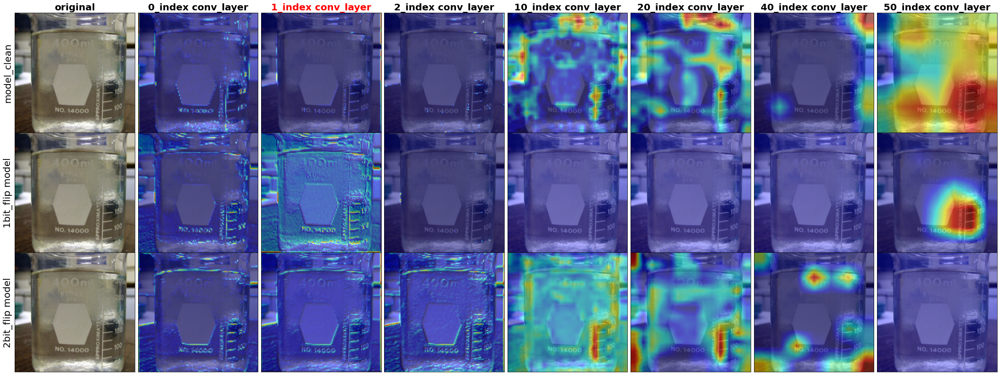

tensor(334)


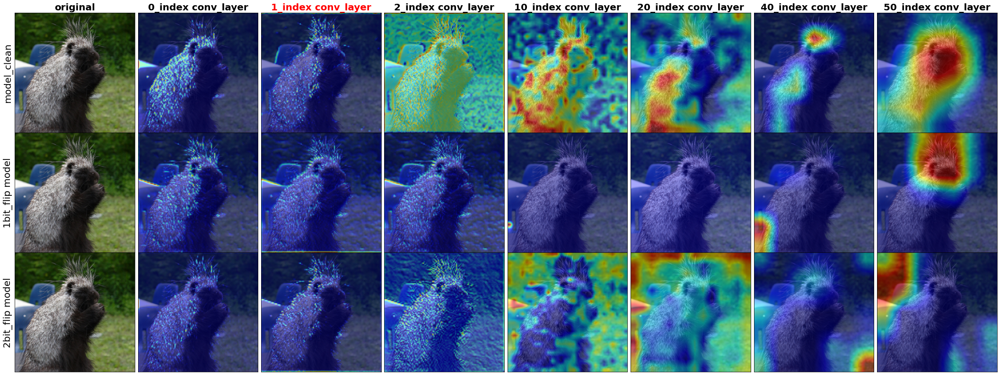

tensor(417)


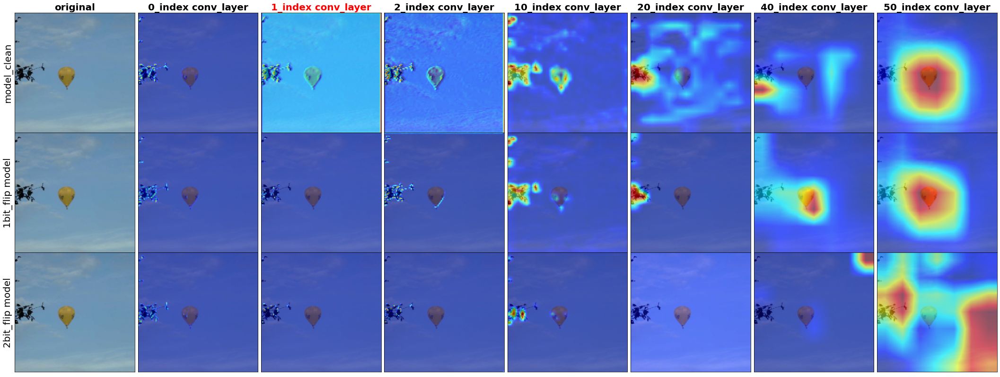

tensor(139)


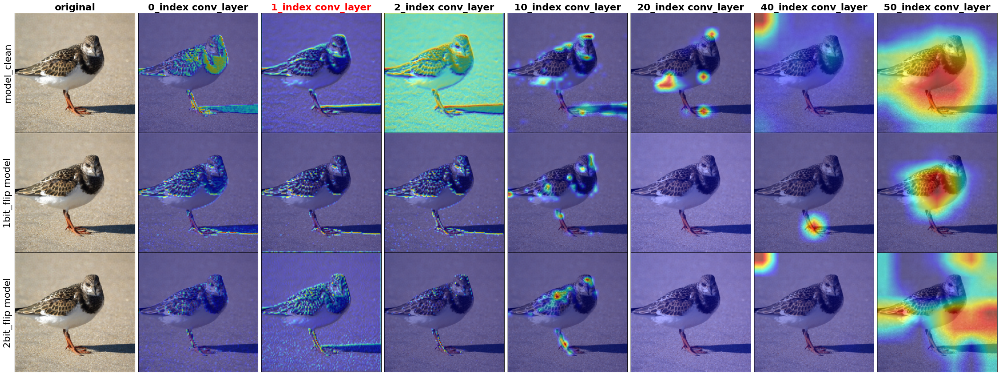

In [26]:
model_arr = [net_clean, net_attack, net_attack2]
image_arr = [3, 6, 7, 8]
layer_target_arr = [0, 1, 2, 10, 20, 40, 50] 
model_name_arr = ["model_clean", "1bit_flip model", "2bit_flip model"]
grad_arr =compare_cam(model_arr=model_arr, data=true_data, target=true_target, mean=mean, std=std, image_idx_arr=image_arr, layer_target_arr=layer_target_arr, find_func="count",true_class_idx=True)
grad_arr_to_plt(grad_arr, model_name_arr, layer_target_arr, attack_index=[2], true_class=True, image_arr=image_arr, target_arr=true_target)

predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False detect
predict target False

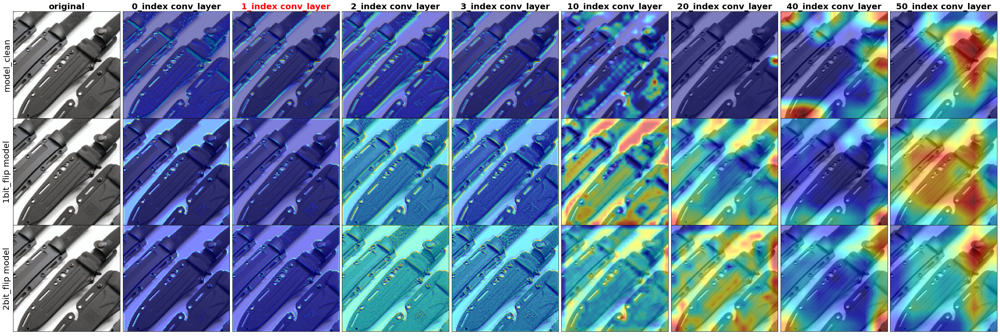

tensor(334)


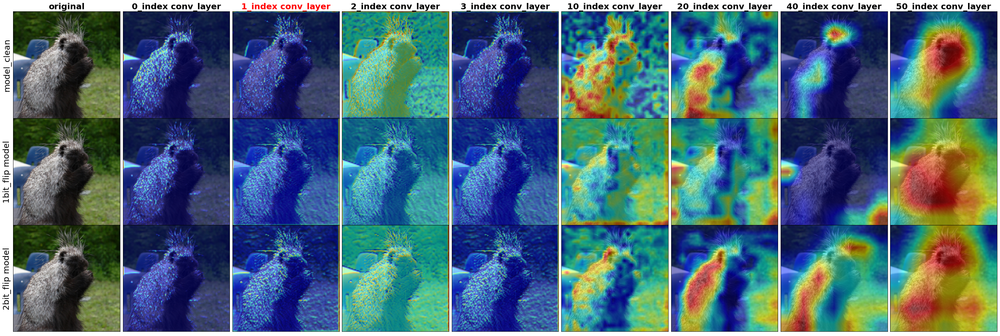

tensor(417)


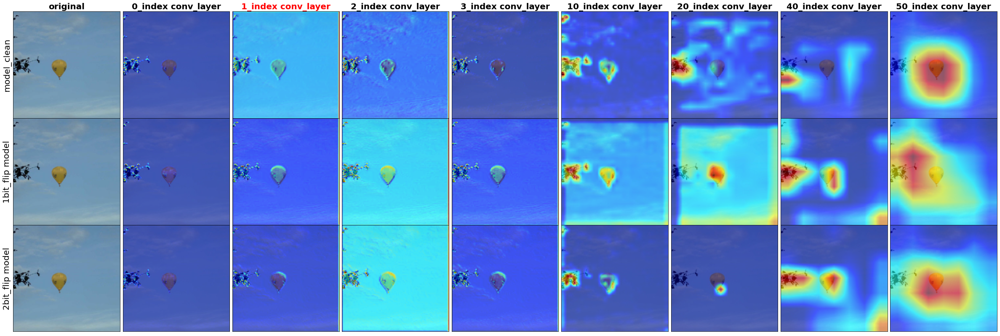

tensor(139)


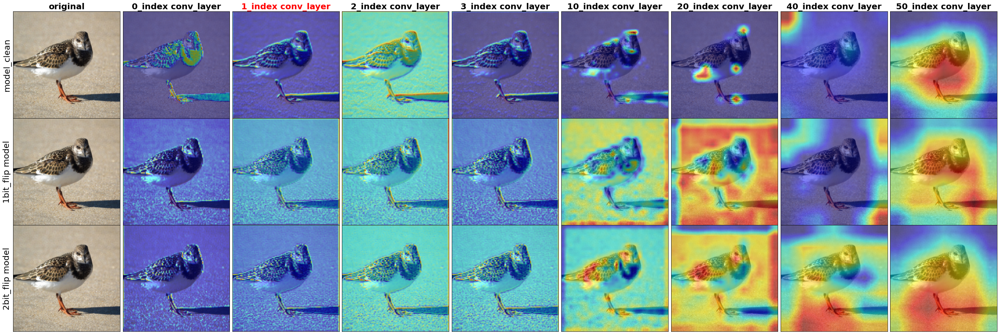

tensor(369)


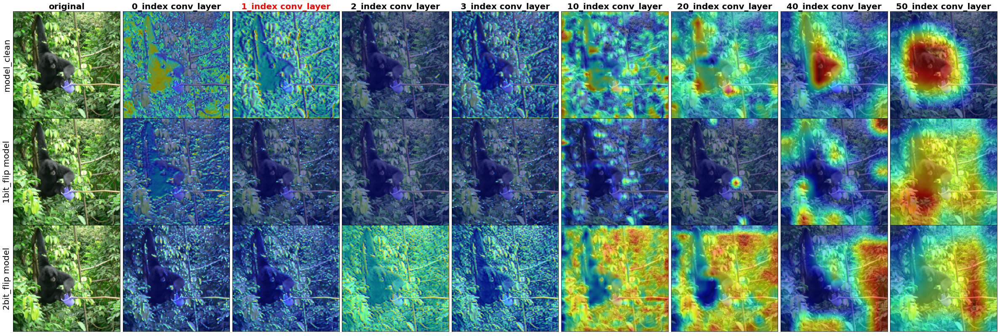

tensor(421)


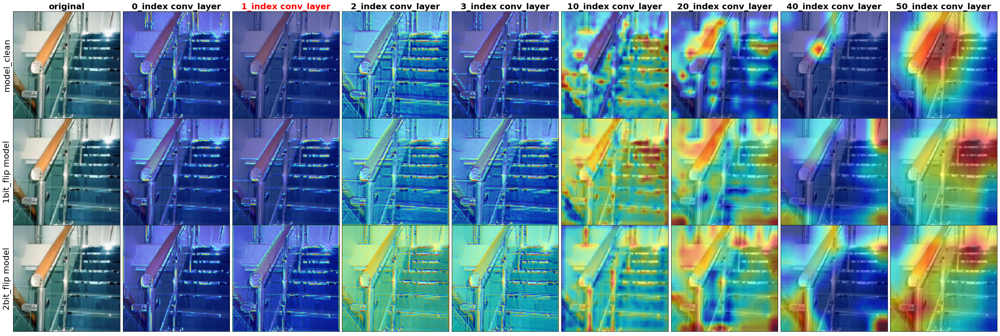

In [28]:
model_arr = [net_clean, net_attack, net_attack2]
image_arr = [5, 6, 7, 8, 9, 10]
layer_target_arr = [0, 1, 2, 3, 10, 20,40, 50] 
model_name_arr = ["model_clean", "1bit_flip model", "2bit_flip model"]
grad_arr =compare_cam(model_arr=model_arr, data=true_data, target=true_target, mean=mean, std=std, image_idx_arr=image_arr, layer_target_arr=layer_target_arr, find_func="count",true_class_idx=False)
grad_arr_to_plt(grad_arr, model_name_arr, layer_target_arr, attack_index=[2], true_class=False, image_arr=image_arr, target_arr=true_target)

In [ ]:
#first _ net_clean feature_map

img3 = make_grid(grad_arr[2][0][0])

plt.figure(figsize=(14, 10))
plt.imshow(img3.permute(1,2,0))

In [ ]:
#first _ net_clean feature_map

img = make_grid(score_arr[0][0][0])
#img = make_grid(attack_grad_layer[index])

plt.figure(figsize=(14, 10))
plt.imshow(img.permute(1,2,0))

In [ ]:
#first _ net_clean feature_map

img2 = make_grid(score_arr[1][0][0])

plt.figure(figsize=(14, 10))
plt.imshow(img2.permute(1,2,0))